# Inferencing with Detectron2 Pretrained Models

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

### Installing Detectron2

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 8.6 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15837, done.
remote: Counting objects: 100% (56/56), done.
remote: Compressing objects: 100% (44/44), done.
remote: Total 15837 (delta 30), reused 12 (delta 12), pack-reused 15781 (from 2)
Receiving objects: 100% (15837/15837), 6.40 MiB | 10.83 MiB/s, done.
Resolving deltas: 100% (11537/11537), done.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your e

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
torch:  2.6 ; cuda:  cu124
detectron2: 0.6


### Imports

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Run Multiple pre-trained detectron2 models

Explore Multiple models [LINK](https://github.com/facebookresearch/detectron2/blob/main/MODEL_ZOO.md#coco-object-detection-baselines)

### Inferencing with Faster RCNN Resnet50 Model

Get our Inference Test Image

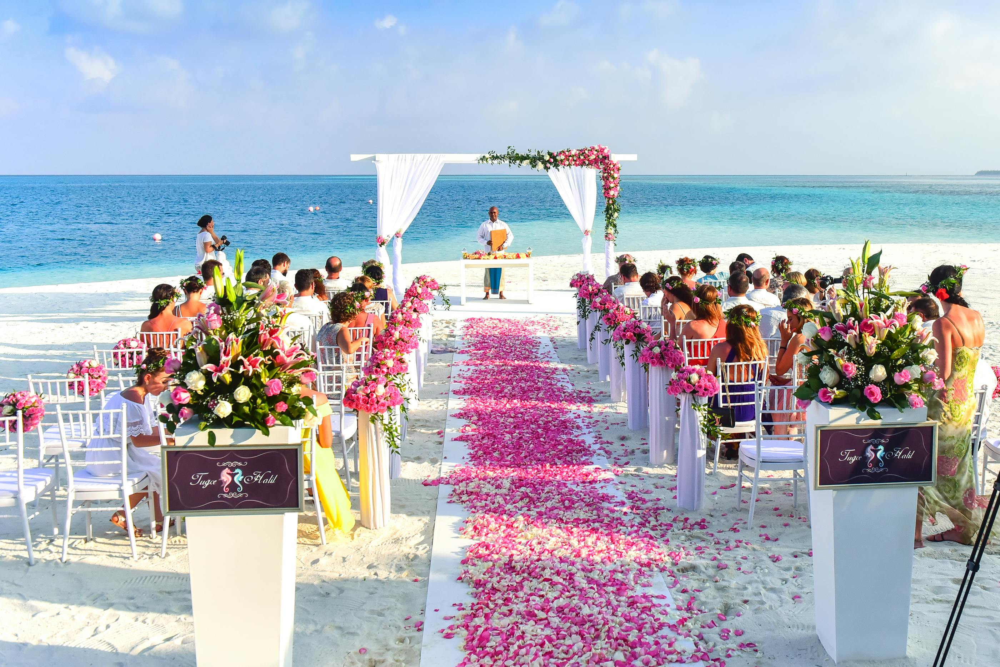

In [ ]:
im = cv2.imread("/content/pexels-photo-169198.jpeg")
cv2_imshow(im)

### Loading the Pretrained Model & Config File

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

[03/16 08:22:13 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_1x/137257794/model_final_b275ba.pkl ...


model_final_b275ba.pkl: 167MB [00:01, 117MB/s]                           
/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


### Let's look in the model output

In [ ]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([ 0, 56,  0,  0,  0, 56,  0, 58,  0, 75,  0,  0,  0,  0, 56, 25, 58,  0,
         0, 58, 56,  0,  0,  0,  0], device='cuda:0')
Boxes(tensor([[1.3359e+03, 5.7775e+02, 1.4328e+03, 8.4583e+02],
        [1.4872e+02, 1.1709e+03, 4.3241e+02, 1.5478e+03],
        [5.4408e+02, 6.0113e+02, 6.4308e+02, 7.9327e+02],
        [7.8677e+02, 7.4949e+02, 9.2772e+02, 9.9251e+02],
        [3.8717e+02, 7.9460e+02, 5.3577e+02, 9.8340e+02],
        [1.9684e+03, 1.0285e+03, 2.1419e+03, 1.3891e+03],
        [3.2787e+02, 9.8714e+02, 4.8549e+02, 1.4935e+03],
        [2.2119e+03, 6.8850e+02, 2.6700e+03, 1.3634e+03],
        [4.8354e+02, 7.6916e+02, 5.9040e+02, 9.1543e+02],
        [1.8934e+03, 1.1204e+03, 1.9807e+03, 1.4443e+03],
        [1.8543e+03, 7.7415e+02, 1.9562e+03, 9.4750e+02],
        [1.6942e+03, 7.1833e+02, 1.7941e+03, 8.2837e+02],
        [1.9740e+03, 8.4855e+02, 2.1601e+03, 1.1632e+03],
        [1.9110e+03, 8.0099e+02, 2.0399e+03, 1.0211e+03],
        [2.0609e+03, 1.1701e+03, 2.2601e+03, 1.4

### Visualizing the predicted image

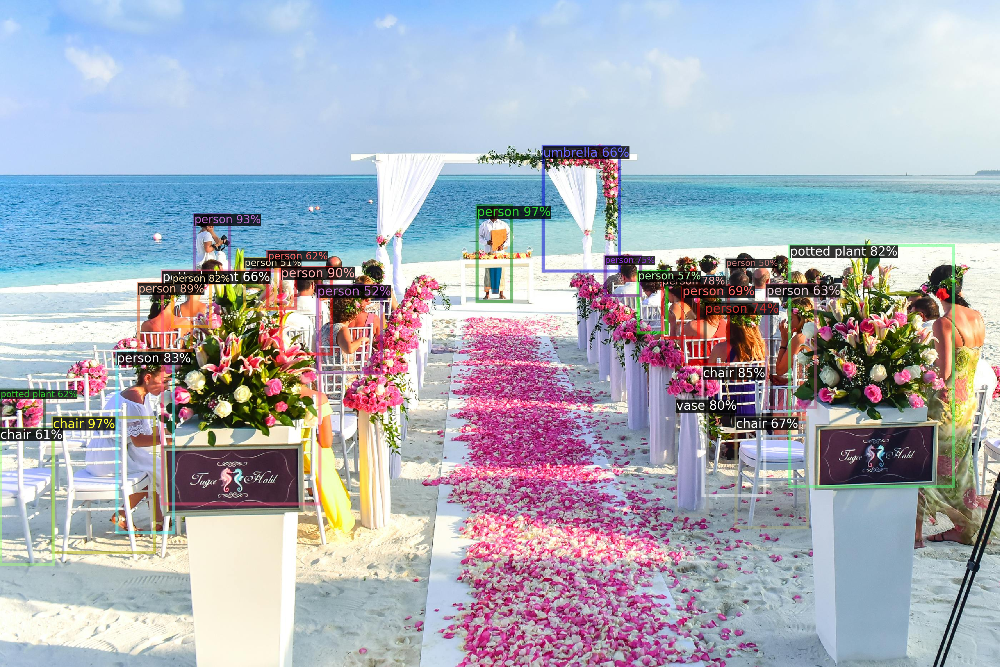

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

### Inferencing with Faster RCNN Resnet101 Model

### Loading the Pretrained Model & Config File

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

[03/16 08:23:22 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl ...


model_final_f6e8b1.pkl: 243MB [00:01, 233MB/s]                           


### Let's look in the model output

In [ ]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([56,  0,  0, 56, 75,  0,  0,  0,  0, 56, 58,  0,  0,  0,  0,  0,  0,  0,
         0,  0, 75,  0,  0, 58, 25,  0,  0, 56, 58,  0,  0,  0,  0,  0],
       device='cuda:0')
Boxes(tensor([[1.5289e+02, 1.1526e+03, 4.3534e+02, 1.5866e+03],
        [5.4599e+02, 6.0050e+02, 6.4431e+02, 7.7986e+02],
        [2.6566e+02, 9.8476e+02, 4.9382e+02, 1.5269e+03],
        [2.0592e+03, 1.0775e+03, 2.2585e+03, 1.4832e+03],
        [1.8917e+03, 1.1251e+03, 1.9751e+03, 1.4366e+03],
        [1.3285e+03, 5.7579e+02, 1.4417e+03, 8.4214e+02],
        [7.7424e+02, 7.5144e+02, 9.3118e+02, 1.0098e+03],
        [4.7997e+02, 7.7497e+02, 5.9225e+02, 9.3906e+02],
        [3.8581e+02, 7.9752e+02, 5.3753e+02, 9.7326e+02],
        [1.4200e+00, 1.2143e+03, 1.5428e+02, 1.5813e+03],
        [1.4614e+00, 1.0935e+03, 1.2893e+02, 1.2117e+03],
        [1.6920e+03, 7.1332e+02, 1.7901e+03, 8.2252e+02],
        [1.9891e+03, 8.4808e+02, 2.1522e+03, 1.0832e+03],
        [1.7829e+03, 7.5860e+02, 1.8695e+03, 9.3891e+02],
     

### Visualizing the predicted image

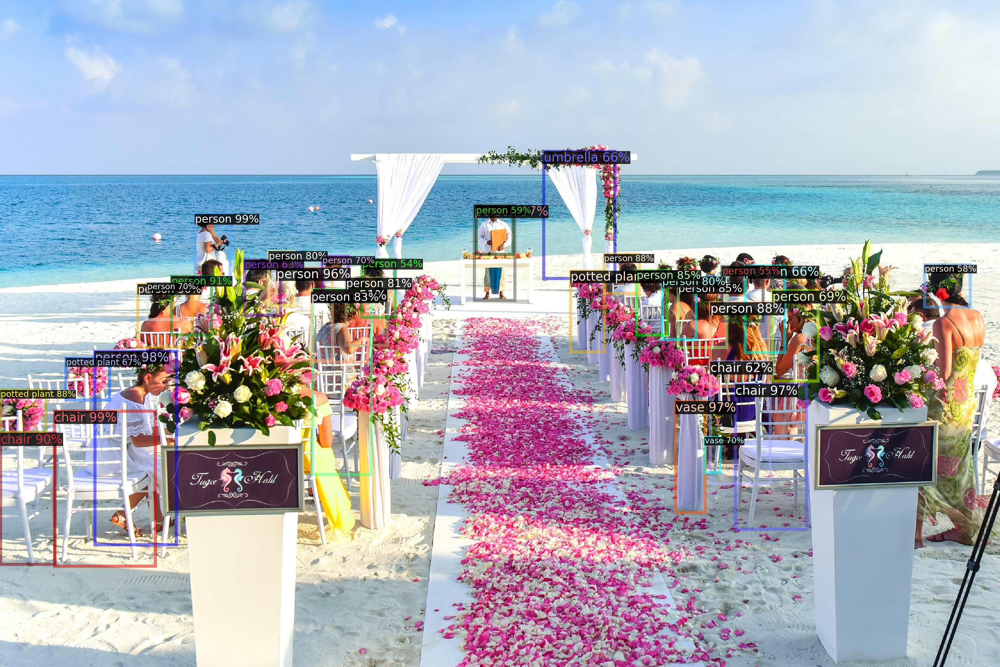

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])